# scVelo-RNA velocity analysis of keratinocytes (CellRank)

## Part 1.  RNA velocity analysis per condition separately

In [1]:
import scvelo as scv
import scanpy as sc
import cellrank as cr
import numpy as np
import os
import pandas as pd
import anndata as ad
scv.logging.print_version()
sc.logging.print_header()

Running scvelo 0.2.4 (python 3.8.12) on 2022-02-18 17:14.


ERROR: XMLRPC request failed [code: -32500]
RuntimeError: PyPI's XMLRPC API is currently disabled due to unmanageable load and will be deprecated in the near future. See https://status.python.org/ for more information.


scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.21.5 scipy==1.8.0 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.1 python-igraph==0.9.9 louvain==0.7.1 pynndescent==0.5.6


In [2]:
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.presenter_view = True  # set max width size for presenter view
cr.settings.presenter_view = True
scv.settings.set_figure_params('scvelo', facecolor='white', dpi=300, frameon=False) # for beautified visualization
cr.settings.verbosity = 2

import warnings

warnings.simplefilter("ignore", category=UserWarning)
warnings.simplefilter("ignore", category=FutureWarning)
warnings.simplefilter("ignore", category=DeprecationWarning)

## Part 2. RNA velocity analysis per condition (From combined anndata)

### 1. All combined skin and wounds

In [3]:
# load the combined data (SC and loom files)
adata = sc.read_h5ad('allNew_zs4_RNAvelocity_allCondis.h5ad')

# only keep the skin and filter out unneeded clusters
adata = adata[adata.obs['Condition'].isin(["Wound1"])]

#cur_celltypes = ['cl13'] 
#adata = adata[~adata.obs['seurat_clusters'].isin(cur_celltypes)]

Trying to set attribute `._uns` of view, copying.


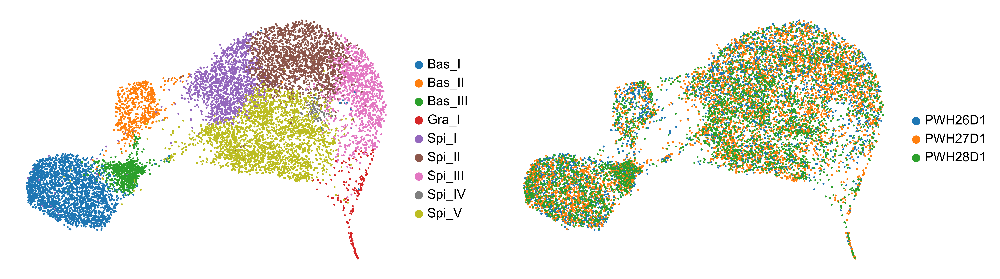

In [4]:
sc.pl.umap(adata, color=['CellTypes', 'orig.ident'], frameon=False, title=['', '']) #'orig.ident', 

#### 1.2 CellRank RNA Velocities

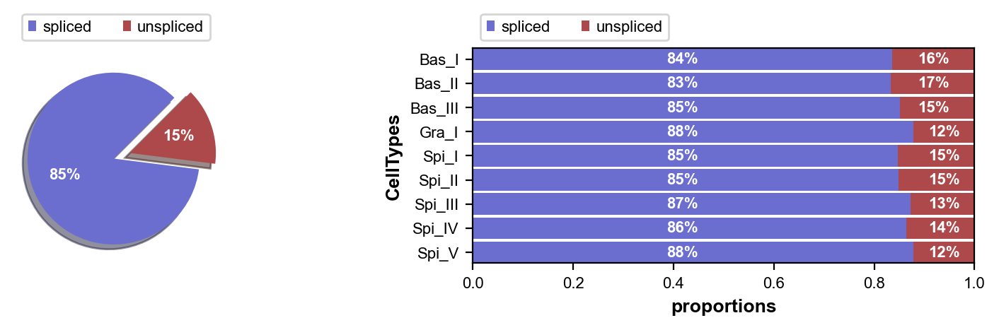

In [5]:
sc.pp.filter_cells(adata, min_genes=1)
# the proportion of spliced and unspliced transcripts in each of our cell clusters. 
scv.pl.proportions(adata, groupby='CellTypes')

In [6]:
scv.utils.show_proportions(adata)

Abundance of ['spliced', 'unspliced']: [0.85 0.15]


In [19]:
# pre-process
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000, min_shared_cells=10)
scv.pp.moments(adata, n_pcs=20, n_neighbors=20)

Skip filtering by dispersion since number of variables are less than `n_top_genes`.
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


computing velocity graph (using 1/12 cores)
    finished (0:02:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


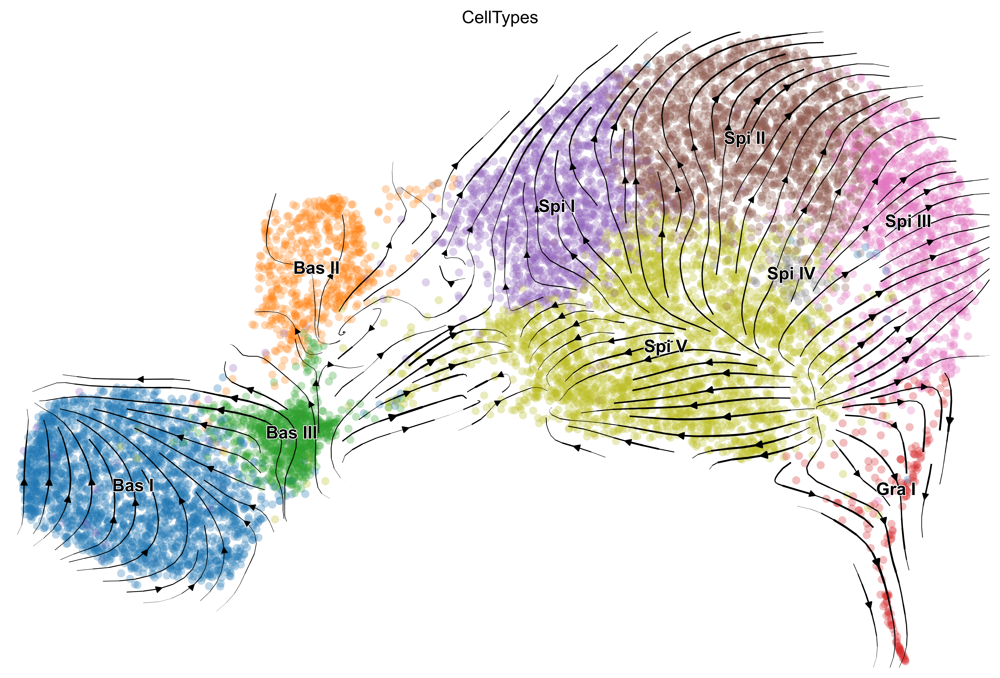

In [20]:
# compute velocity
#scv.tl.recover_dynamics(adata, n_jobs=6) #If using dynamical model
#scv.tl.velocity(adata, mode='dynamical') #Other models, 'deterministic', 'dynamical'(run the tl.recover_dynamics first)
#scv.tl.velocity_graph(adata)

#scv.tl.velocity(adata, mode='stochastic')#, deterministic, stochastic
scv.tl.velocity_graph(adata)
scv.pl.velocity_embedding_stream(adata, basis='umap', color='CellTypes')

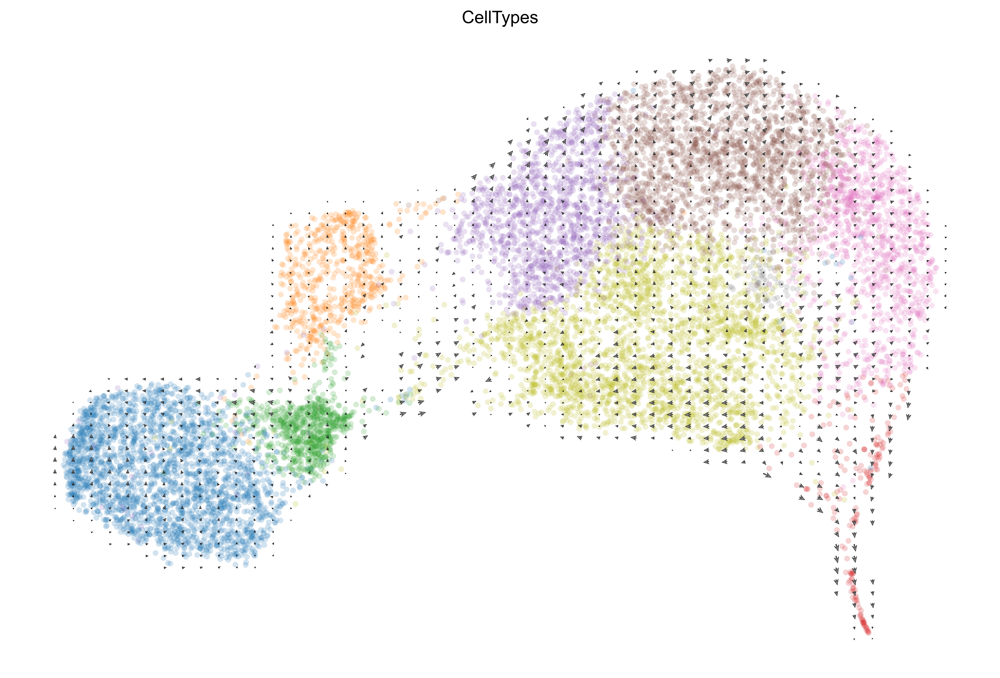

In [12]:
scv.pl.velocity_embedding_grid(adata, basis='umap', color='CellTypes')

In [9]:
# Screening through the top-likelihood genes
scv.tl.recover_dynamics(adata, n_jobs=8)

recovering dynamics (using 8/12 cores)
    finished (0:13:41) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [10]:
# Check and select the top likelihood genes
print(adata.var['velocity_genes'].sum(), adata.n_vars, adata.n_obs)
top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index[:100]
scv.tl.differential_kinetic_test(adata, var_names=top_genes, groupby='CellTypes')

1197 2000 27105
testing for differential kinetics
    finished (0:01:14) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pvals_kinetics', p-values of differential kinetics (adata.var)


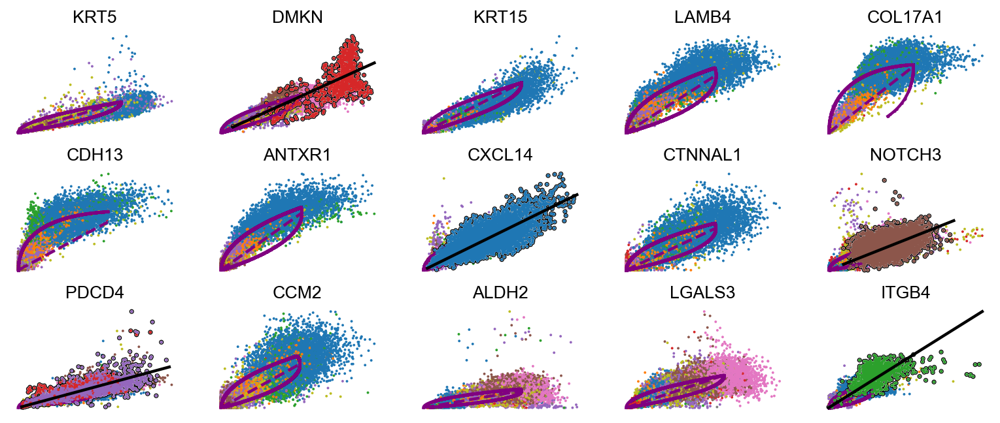

In [11]:
kwargs = dict(linewidth=2, add_linfit=True, frameon=False)

scv.pl.scatter(adata, 
               basis=top_genes[:15], 
               ncols=5, 
               add_outline='fit_diff_kinetics', **kwargs, 
               color='CellTypes')

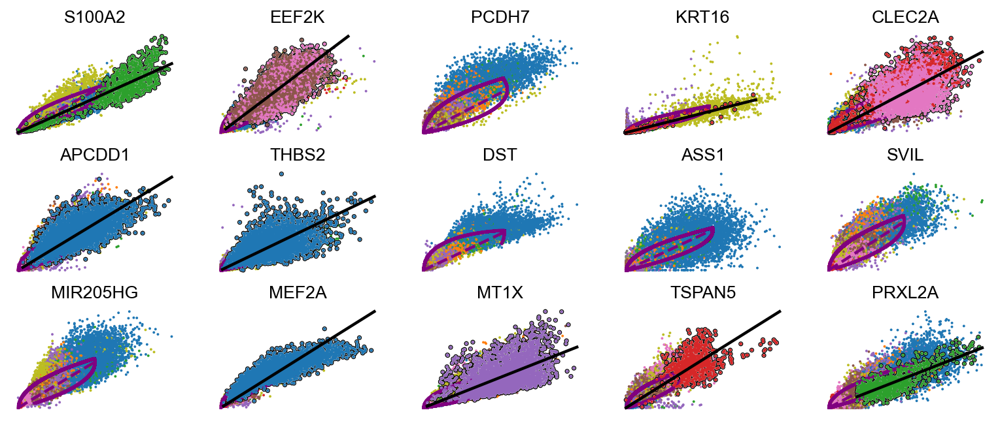

In [12]:
scv.pl.scatter(adata, 
               basis=top_genes[15:30], 
               ncols=5, 
               add_outline='fit_diff_kinetics', **kwargs, 
               color='CellTypes')

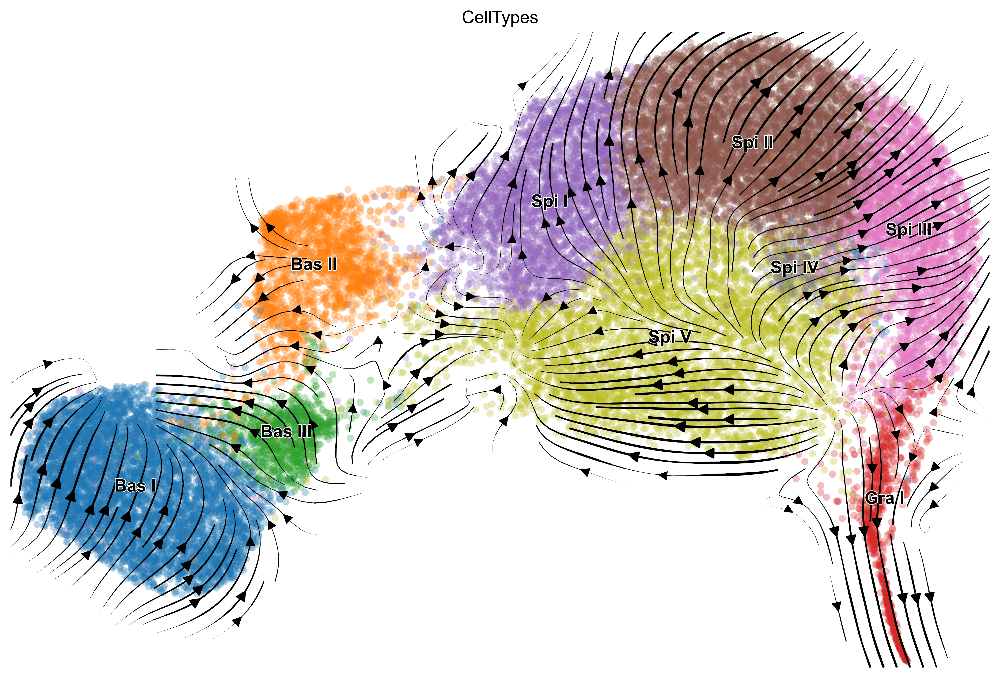

In [23]:
# Recompute velocities
#scv.tl.velocity(adata, mode='stochastic', diff_kinetics=True)#, deterministic, stochastic
#scv.tl.velocity_graph(adata)
scv.pl.velocity_embedding_stream(adata, basis='umap', color='CellTypes', arrow_size=1.5, smooth=0.8, density=2.5)

computing terminal states
    identified 5 regions of root cells and 1 region of end points .
    finished (0:00:04) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:07) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


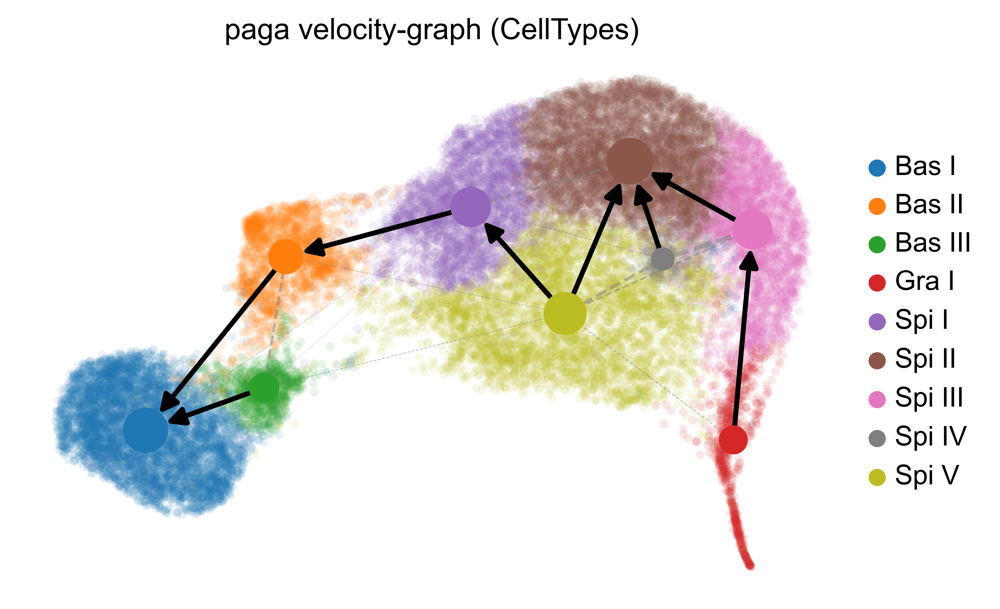

In [14]:
adata.uns['neighbors']['distances'] = adata.obsp['distances']
adata.uns['neighbors']['connectivities'] = adata.obsp['connectivities']

scv.tl.paga(adata, groups='CellTypes')
df = scv.get_df(adata, 'paga/transitions_confidence', precision=2).T
df.style.background_gradient(cmap='Blues').format('{:.2g}')

scv.pl.paga(adata, basis='umap', size=50, alpha=.1,
            min_edge_width=2, node_size_scale=1.5, color='CellTypes')

computing terminal states
    identified 5 regions of root cells and 1 region of end points .
    finished (0:00:04) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:07) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


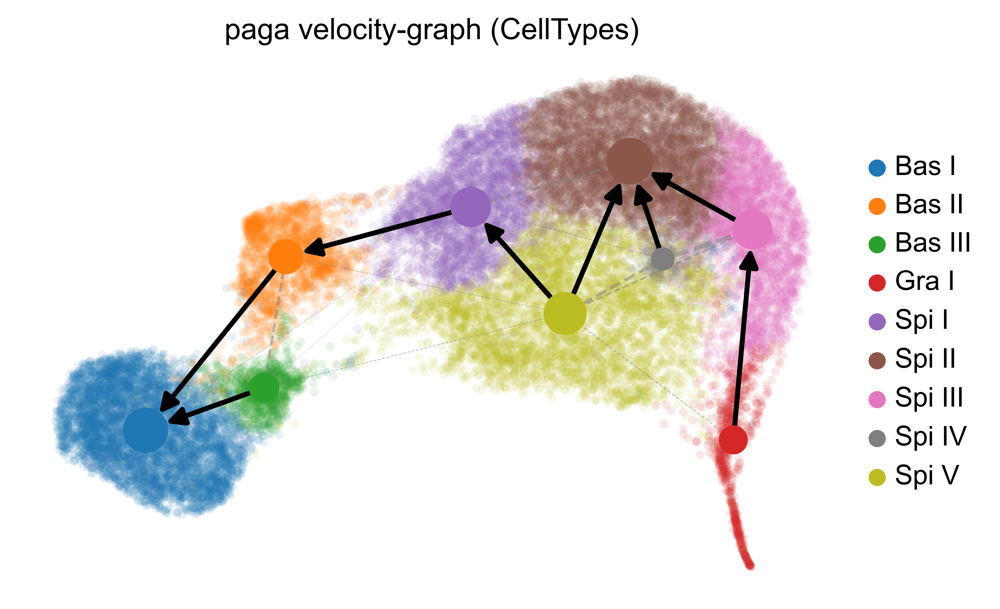

In [14]:
adata.uns['neighbors']['distances'] = adata.obsp['distances']
adata.uns['neighbors']['connectivities'] = adata.obsp['connectivities']

scv.tl.paga(adata, groups='CellTypes')
df = scv.get_df(adata, 'paga/transitions_confidence', precision=2).T
df.style.background_gradient(cmap='Blues').format('{:.2g}')

scv.pl.paga(adata, basis='umap', size=50, alpha=.1,
            min_edge_width=2, node_size_scale=1.5, color='CellTypes')

# CytoTRACE

In [ ]:
# load the combined data (SC and loom files)
adata = sc.read_h5ad('allNew_zs4_RNAvelocity_allCondis.h5ad')

# only keep the skin and filter out unneeded clusters
#adata = adata[adata.obs['Condition'].isin(["Skin"])]

#cur_celltypes = ['cl13'] 
#adata = adata[~adata.obs['seurat_clusters'].isin(cur_celltypes)]

In [ ]:
scv.pl.scatter(adata, basis="umap", c="CellTypes", legend_loc="right")

In [ ]:
scv.pl.scatter(adata, basis="umap", c="Condition", legend_loc="right")

In [ ]:
# Before we can start applying the CytoTRACE kernel, we’ll have to do some basic pre-processing of the data
# filter, normalize total counts and log-transform
sc.pp.filter_genes(adata, min_cells=10)
scv.pp.normalize_per_cell(adata)
sc.pp.log1p(adata)

# hvg annotation
sc.pp.highly_variable_genes(adata)
print(f"This detected {np.sum(adata.var['highly_variable'])} highly variable genes. ")

# use scVelo's `moments` function for imputation - note that hack we're using here:
# we're copying our `.X` matrix into the layers because that's where `scv.tl.moments`
# expects to find counts for imputation
adata.layers["spliced"] = adata.X
adata.layers["unspliced"] = adata.X
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)

In [ ]:
adata.layers

In [ ]:
# Import the kernel and initialize it using the pre-processed AnnData object
from cellrank.tl.kernels import CytoTRACEKernel

ctk = CytoTRACEKernel(adata)

In [ ]:
scv.pl.scatter(
    adata,
    c=["ct_pseudotime", "CellTypes", "Condition"],
    basis="umap",
    legend_loc="right",
    color_map="gnuplot2",
)

In [ ]:
sc.pl.violin(adata, keys=["ct_pseudotime"], groupby="CellTypes", rotation=90)

In [ ]:
# First thing we need to do is to actually compute the transition matrix:
ctk.compute_transition_matrix(threshold_scheme="soft", nu=0.5)

In [ ]:
ctk.compute_projection(basis="umap")
scv.pl.velocity_embedding_stream(
    adata, color="CellTypes", vkey="T_fwd", basis="umap", legend_loc="right"
)

In [ ]:
ctk.plot_random_walks(
    n_sims=15,
    start_ixs={"CellTypes": "Bas_I"},
    basis="umap",
    color="CellTypes",
    legend_loc="right",
    seed=1,
)